This nb explores how well different matching techniques perform and qualitative examples of what the matches look like.

In [1]:
%load_ext autoreload
%autoreload 2

import sys

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import sklearn.manifold
from matplotlib.image import BboxImage
from matplotlib.transforms import Bbox, TransformedBbox
from tqdm import tqdm
sys.path.append('..')
sys.path.append('../projection_manipulation')

import data
import util
from matching import *
from config import *

df = data.load_all_labs()
df = df.set_index('fname_id')

# get fnames
fname_nps = [f for f in sorted(os.listdir(DIR_GEN)) if 'npy' in f] # these start at 00001
fname_ids = np.array([f[:-4] for f in fname_nps])

## calculating / loading dists

In [2]:
'''
# This does not need to be run if gan dists are precomputed
# load latents and calculate gan dists
print('loading latents...')
latents = np.array([np.load(oj(DIR_GEN, f)) for f in fname_nps])
lats = get_lat(latents)
preds = latents.mean(axis=1) @ coefs.T + intercepts.T
weights = np.zeros(preds.shape[1])
# print(ATTR_TO_INDEX)
# weights[ATTR_TO_INDEX['skin-color']] = 1e2
vecs = join_vecs(preds, lats, weights)
dists_gan = calc_dists_from_latents(vecs)
print(dists_gan.shape)
np.save(open(oj(DIR_PROCESSED, 'dists_pairwise_gan.npy'), 'wb'), dists_gan)
print('done!')
'''

"\n# This does not need to be run if gan dists are precomputed\n# load latents and calculate gan dists\nprint('loading latents...')\nlatents = np.array([np.load(oj(DIR_GEN, f)) for f in fname_nps])\nlats = get_lat(latents)\npreds = latents.mean(axis=1) @ coefs.T + intercepts.T\nweights = np.zeros(preds.shape[1])\n# print(ATTR_TO_INDEX)\n# weights[ATTR_TO_INDEX['skin-color']] = 1e2\nvecs = join_vecs(preds, lats, weights)\ndists_gan = calc_dists_from_latents(vecs)\nprint(dists_gan.shape)\nnp.save(open(oj(DIR_PROCESSED, 'dists_pairwise_gan.npy'), 'wb'), dists_gan)\nprint('done!')\n"

In [5]:
dists_gan = data.get_dists('gan')
dists_facial = data.get_dists('facial')
# dists_facial = data.get_dists('facenet_vgg2')
dists_vgg = data.get_dists('vgg')

# do matching

### find matching for an im

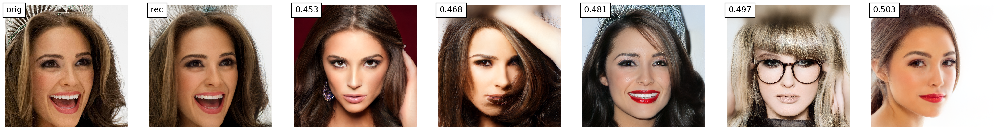

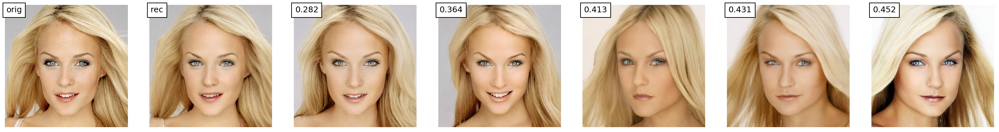

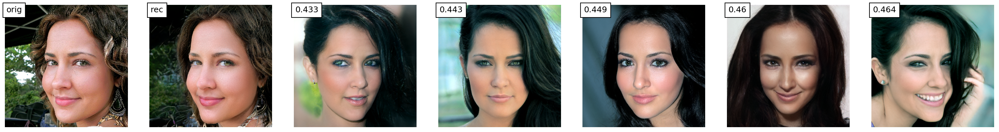

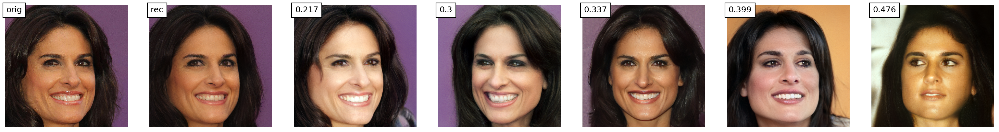

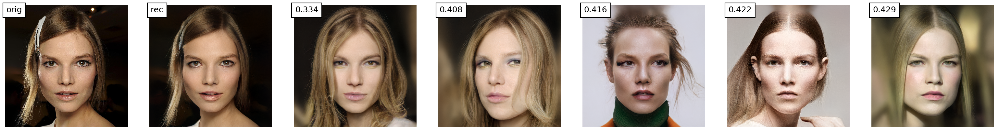

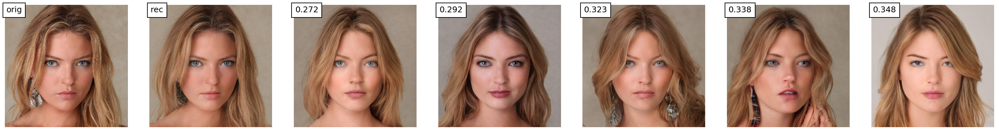

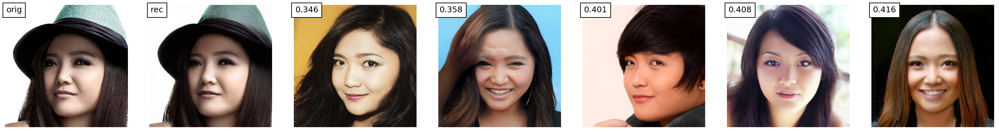

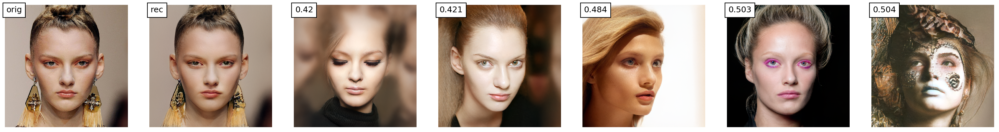

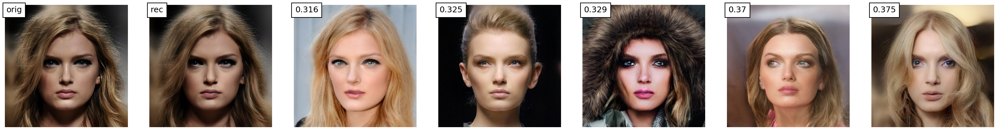

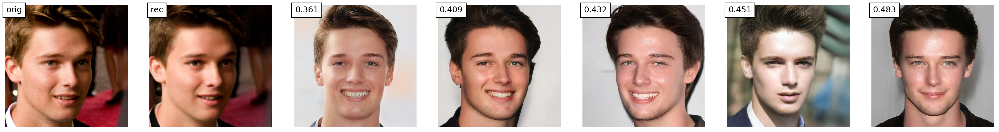

In [6]:
dists = dists_facial
N_MATCHES_TO_PLOT = 5

for im_idx in range(10):# range(38, 45):
    
    # select subset of indices to use for matching
    idxs = np.ones(df.shape[0]).astype(bool)
#     idxs = (df['gender'] > 0).values
#     idxs = (df['race'] == 'Black').values
#     idxs = (df['Eyeglasses'] > 0).values
    dists_im = dists[im_idx][idxs] # first select row, then select vals
    fname_ids_for_matching = fname_ids[idxs]    
    closest_match_vals, closest_matches_fnames = calc_matches(dists_im, fname_ids_for_matching)
    
    # load images
    fname_id = fname_ids[im_idx]
    im_orig = mpimg.imread(oj(DIR_IMS, f'{fname_id}.jpg'))
    im_rec = mpimg.imread(oj(DIR_GEN, f'{fname_id}.png'))
    im_matches = [mpimg.imread(oj(DIR_GEN, f'{fname_match}.png'))
                  for fname_match in closest_matches_fnames[:N_MATCHES_TO_PLOT]]
    
    # plt images
    util.plot_row([im_orig, im_rec] + im_matches,
                  annot_list=['orig', 'rec'] + closest_match_vals[:N_MATCHES_TO_PLOT].round(3).tolist(), dpi=150)
    plt.show()

**match many dist types**

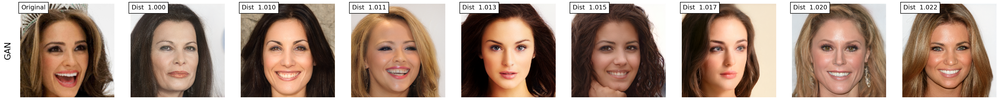

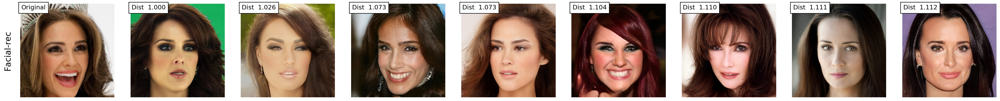

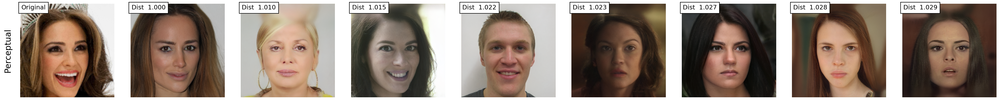

In [4]:
dists = dists_vgg
N_MATCHES_TO_PLOT = 8
im_idx = 0
for dists, dist_name in zip([dists_gan, dists_facial, dists_vgg],
                            ['GAN', 'Facial-rec', 'Perceptual']):
    
    # select subset of indices to use for matching
    idxs = np.ones(df.shape[0]).astype(bool)
    dists_im = dists[im_idx][idxs] # first select row, then select vals
    fname_ids_for_matching = fname_ids[idxs]    
    closest_match_vals, closest_matches_fnames = calc_matches(dists_im, fname_ids_for_matching)
    
    # load images
    fname_id = fname_ids[im_idx]
    im_orig = mpimg.imread(oj(DIR_IMS, f'{fname_id}.jpg'))
    im_rec = mpimg.imread(oj(DIR_GEN, f'{fname_id}.png'))
    im_matches = [mpimg.imread(oj(DIR_GEN, f'{fname_match}.png'))
                  for fname_match in closest_matches_fnames[:N_MATCHES_TO_PLOT]]
    dist0 = closest_match_vals[0]
    util.plot_row([im_orig] + im_matches,
                  annot_list=['Original'] + [f'Dist {d/dist0: 0.3f}' for d in 
                                             closest_match_vals[:N_MATCHES_TO_PLOT]],
                  ylab=dist_name,
                  dpi=150)
    util.savefig('dist_' + dist_name.lower().replace(' ', '_'))
    plt.show()

## dim reduction for latent space

In [2]:
latents = np.array([np.load(oj(DIR_GEN, f)) for f in fname_nps])
lats = get_lat(latents)

In [5]:
def plot_image(xs, ys, im, IM_SIZE=0.025):
    '''Note: should normalize x/y coords to 0-1 before plotting
    '''
    for idx, (x, y) in tqdm(enumerate(zip(xs, ys))):
        bb = Bbox.from_bounds(x, y, IM_SIZE, IM_SIZE)  
        bb2 = TransformedBbox(bb, ax.transData)
        bbox_image = BboxImage(bb2, origin=None, clip_on=False)
        bbox_image.set_data(im[idx])
#          bbox_image.set_alpha(1.0)
        ax.add_artist(bbox_image)
    return ax

# plot
N_IMS = 100 # 1500
N_PLOT = 1500
methods = ['pca', 'tsne'] # pca, tsne
models = [sklearn.decomposition.PCA(n_components=2, random_state=42), sklearn.manifold.TSNE(random_state=42)]

for name, m in zip(methods, models):
    # fit
    print('fitting', name)
    l = m.fit_transform(lats[:N_IMS])
    l = (l - l.min(axis=0)) / (l.max(axis=0) - l.min(axis=0))
    
    # read ims
    ims = [mpimg.imread(oj(DIR_IMS, f))[::2, ::2] for f in df.fname_final[:N_IMS]]
    
    # plot
    fig = plt.figure(figsize=(20, 20), dpi=100)
    ax = fig.add_subplot(111)
    if name == 'pca':
        ax = plot_image(l[:N_PLOT, 0], l[:N_PLOT, 1], ims)
    if name == 'tsne':
        plt.xlim((0, 0.4))
        plt.ylim((0.6, 1.0))
        idxs_good = l[:N_PLOT, 0] < 0.4
        l = l[idxs_good]
        ax = plot_image(l[:N_PLOT, 0], l[:N_PLOT, 1], ims, IM_SIZE=0.0125)
    plt.xlabel(name.capitalize() + ' dim 1')
    plt.ylabel(name.capitalize() + ' dim 2')        
    util.savefig('dim_reduction_' + name)

fitting pca


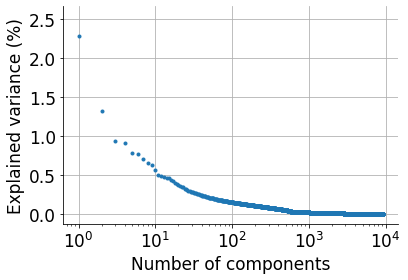

In [31]:
m = sklearn.decomposition.PCA(random_state=42)
m.fit(lats[:10000])
plt.plot(np.arange(m.explained_variance_.size), 100 * m.explained_variance_ratio_, '.')
plt.ylabel('Explained variance (%)')
plt.xscale('log')
plt.xlabel('Number of components')
plt.grid()

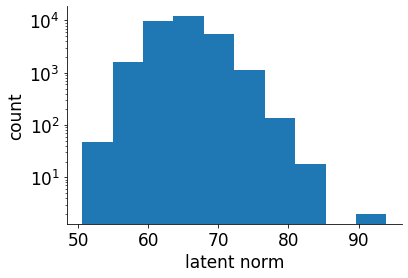

In [32]:
norms = np.linalg.norm(lats[:30000], axis=1)
plt.hist(norms)
plt.yscale('log')
plt.ylabel('count')
plt.xlabel('latent norm')
plt.show()

# plots for specific ids/matches

**make some plots for a specific match**

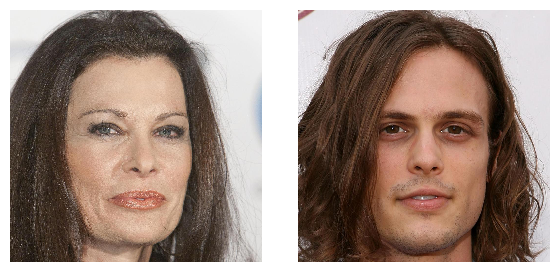

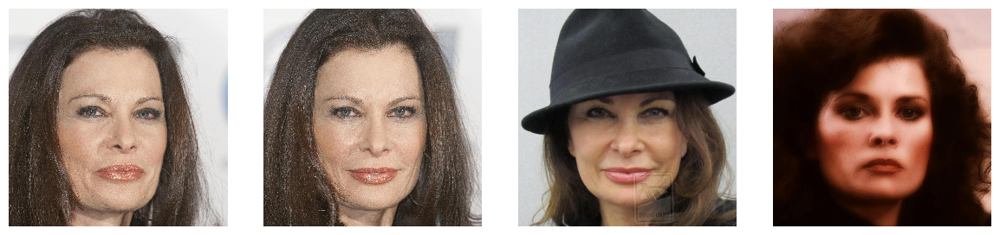

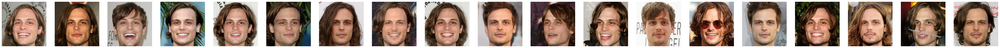

In [19]:
im_idx = 38 # img 38 is a good gender example
fname_id2 = '02638' # this is the match
# if all images are calculated, then this is just 5-char string of im_idx + 1
fname_id = fname_ids[im_idx] 


# idxs
im = mpimg.imread(oj(DIR_IMS, f'{fname_id}.jpg'))
im2 = mpimg.imread(oj(DIR_IMS, f'{fname_id2}.jpg'))

d1 = df[df.id == df.loc[fname_id].id]
d2 = df[df.id == df.loc[fname_id2].id]



util.plot_row([im, im2])
util.plot_row([mpimg.imread(oj(DIR_IMS, f)) for f in d1.fname_final])
util.plot_row([mpimg.imread(oj(DIR_IMS, f)) for f in d2.fname_final])

**look at images / reconstructions of the same person**

In [ ]:
d = df[df['count_with_this_id'] >= df['count_with_this_id'].max() - 1]
dd = d[d.id == d.iloc[0].id]
util.plot_row([mpimg.imread(oj(DIR_IMS, f)) for f in dd.fname_final][:5])
util.plot_row([mpimg.imread(oj(DIR_GEN, f'{index}.png')) for index in dd.index][:5])

## relationships between different dists

In [3]:
dists_facial = data.get_dists('facial')

0.7931316375622193 0.8232508660296333
0.8048117100760447 0.859060314203589
0.8606563946506801 0.8585830798014851
0.877861093925158 0.8890211496016713
0.8414389857912447 0.8522161452471597
0.8503410377429004 0.8755570203372304
0.8651729121417767 0.8837213747934556
0.8850989650637414 0.9108220567457538
0.8339022663389037 0.8590557345247137
0.8392359981298971 0.8445957969970771


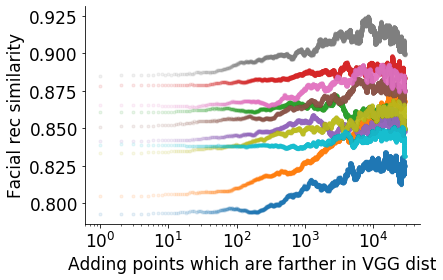

In [42]:
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

for i in range(10):
    args = np.argsort(dists_ref[i])
    recs = dists_facial[i][args]
    recs = recs[recs != 1e3]
    # print(spearmanr(np.arange(recs.size), recs))
    plt.plot(moving_average(recs, n=1000), '.', alpha=0.1)
    plt.xscale('log')
    
    print(np.mean(recs[:1000]), np.mean(recs[1000:]))
plt.xlabel('Adding points which are farther in VGG dist')
plt.ylabel('Facial rec similarity')
plt.show()

In [ ]:
for i in range(10):
    d0 = dists_ref[i]
    d1 = dists_facial[i]
    legal = (d0 != 1e3) & (d1 != 1e3)
    d0 = d0[legal]
    d1 = d1[legal]
    plt.plot(d0, d1, '.', alpha=0.1)
#     print(spearmanr(d0, d1))
plt.xlabel('VGG dist')
plt.ylabel('Facial rec dist')
plt.show()

In [45]:
# means for facial dists between first 1000 vgg points and the rest (is v significant)
means0 = []
means1 = []
for i in tqdm(range(30000)):
    args = np.argsort(dists_ref[i])
    recs = dists_facial[i][args]
    recs = recs[recs != 1e3]    
    means0.append(np.nanmean(recs[:1000]))
    means1.append(np.nanmean(recs[1000:]))
print(np.nanmean(means0), np.nanstd(means0) / np.sqrt(len(means0)))
print(np.nanmean(means1), np.nanstd(means1) / np.sqrt(len(means1)))

100%|██████████| 30000/30000 [01:22<00:00, 364.43it/s]
